In [1]:
using Pkg; Pkg.activate("/home/dhairyagandhi96/temp/model-zoo/script/.."); Pkg.status();

    Status `~/temp/model-zoo/Project.toml`
  [1520ce14] AbstractTrees v0.2.1
  [fbb218c0] BSON v0.2.3
  [54eefc05] Cascadia v0.4.0
  [8f4d0f93] Conda v1.3.0
  [864edb3b] DataStructures v0.17.0
  [31c24e10] Distributions v0.21.3
  [587475ba] Flux v0.9.0
  [708ec375] Gumbo v0.5.1
  [b0807396] Gym v1.1.3
  [cd3eb016] HTTP v0.8.6
  [6218d12a] ImageMagick v0.7.5
  [916415d5] Images v0.18.0
  [e5e0dc1b] Juno v0.7.2
  [ca7b5df7] MFCC v0.3.1
  [91a5bcdd] Plots v0.26.3
  [2913bbd2] StatsBase v0.32.0
  [98b73d46] Trebuchet v0.1.0
  [8149f6b0] WAV v1.0.2
  [10745b16] Statistics 
  [4ec0a83e] Unicode 


Ref: http://blog.otoro.net/2016/03/25/generating-abstract-patterns-with-tensorflow/

In [2]:
using Images
using Flux

set parameters

In [3]:
z_dim = 2
x_dim = 512
y_dim = 512
N = 14
hidden = 9
batch_size = 1024
n = x_dim * y_dim

262144

cast 0:x-1 to -0.5:0.5

In [4]:
cast(x) = [range(-0.5, stop=0.5, step=1/(x - 1))...]

xs, ys = cast(x_dim), cast(y_dim)
xs = repeat(xs, inner=(y_dim))
ys = repeat(ys, outer=(x_dim))
rs = sqrt.(xs.^2 + ys.^2)

262144-element Array{Float64,1}:
 0.7071067811865476
 0.7057243672141199
 0.7043446771602189
 0.702967727063262 
 0.7015935330555991
 0.7002221113638016
 0.6988534783089481
 0.6974876503069023
 0.6961246438685855
 0.6947644756002421
 ⋮                 
 0.6961246438685855
 0.6974876503069023
 0.6988534783089481
 0.7002221113638016
 0.7015935330555991
 0.702967727063262 
 0.7043446771602189
 0.7057243672141199
 0.7071067811865476

sample weigths from a gaussian distribution

In [5]:
unit(in=N, out=N, f=tanh) = Dense(in, out, f, initW=randn)

unit (generic function with 4 methods)

input -> [x, y, r, z...]

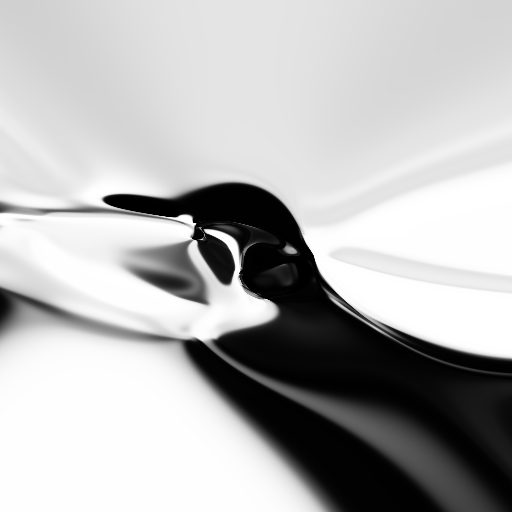

In [6]:
layers = Any[unit(3 + z_dim)]
for i=1:hidden
    push!(layers, unit())
end
push!(layers, unit(N, 1, σ))

model = Chain(layers...)
getColorAt(x) = Flux.data(model(x))

function batch(arr, s)
    batches = []
    l = size(arr, 2)
    for i=1:s:l
        push!(batches, arr[:, i:min(i+s-1, l)])
    end
    batches
end

function getImage(z)
    z = repeat(reshape(z, 1, z_dim), outer=(n, 1))
    coords = hcat(xs, ys, rs, z)'
    coords = batch(coords, batch_size)
    pixels = [Gray.(hcat(getColorAt.(coords)...))...]
    reshape(pixels, y_dim, x_dim)
end

function saveImg(z, image_path=joinpath(dirname(@__FILE__),"sample.png"))
    imgg = getImage(z)
    # save(image_path, imgg)
    imgg
end

saveImg(rand(z_dim))